In [101]:
!pip install PIL opencv-python tensorflow scipy


ERROR: Could not find a version that satisfies the requirement PIL (from versions: none)
ERROR: No matching distribution found for PIL

[notice] A new release of pip is available: 23.3.1 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [102]:

import numpy as np
import matplotlib.pyplot as pathlib
import cv2
import os
import PIL
import tensorflow as tensorflow
import pathlib
import matplotlib.pyplot as plt
from glob import glob
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dropout, Dense,GlobalMaxPooling2D, AveragePooling2D, Flatten, BatchNormalization
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras import optimizers
#from sklearn.metrics import classification_report, confusion_matrix
#from sklearn.model_selection import train_test_split


#load the IMAGES

In [103]:
data_dir='c:/Butterfly'
data_dir=pathlib.Path(data_dir)
data_dir
print(data_dir)


c:\Butterfly


In [104]:
# #getting info about dataset
# dinfo=data_dir.info
# print(info)

In [105]:
img_height=180
img_width=180
batch_size=64

In [106]:
#train=80
train_ds=tensorflow.keras.preprocessing.image_dataset_from_directory(data_dir, validation_split=0.2,subset='training',seed=123)
#val=20
val_ds=tensorflow.keras.preprocessing.image_dataset_from_directory(data_dir, validation_split=0.2,subset='validation',seed=123)


Found 3662 files belonging to 72 classes.
Using 2930 files for training.
Found 3662 files belonging to 72 classes.
Using 732 files for validation.


In [107]:
image_list=list(data_dir.glob('*/*.jpg'))
image_list


[WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00001.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00002.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00003.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00004.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00005.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00006.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00007.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00008.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00009.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00010.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00011.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00012.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00013.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00014.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00015.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00016

In [108]:

image_list.sort()

In [109]:

image_list


[WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00001.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00002.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00003.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00004.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00005.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00006.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00007.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00008.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00009.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00010.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00011.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00012.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00013.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00014.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00015.jpg'),
 WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00016

In [119]:
Clippers=list(data_dir.glob('*Clippers Butterfly/*.jpg'))

Clippers[:5]

[WindowsPath('c:/Butterfly/Clippers Butterfly/Clippers Butterfly SYLIVIA1.jpg'),
 WindowsPath('c:/Butterfly/Clippers Butterfly/Clippers Butterfly SYLIVIA10.jpg'),
 WindowsPath('c:/Butterfly/Clippers Butterfly/Clippers Butterfly SYLIVIA11.jpg'),
 WindowsPath('c:/Butterfly/Clippers Butterfly/Clippers Butterfly SYLIVIA12.jpg'),
 WindowsPath('c:/Butterfly/Clippers Butterfly/Clippers Butterfly SYLIVIA13.jpg')]

In [111]:
Clippers=len(list(data_dir.glob('*Clippers Butterfly/*.jpg')))#length of files Clippers
Clippers

30

In [121]:
image_count=len(list(data_dir.glob('*/*.jpg')))
print(image_count)


3482


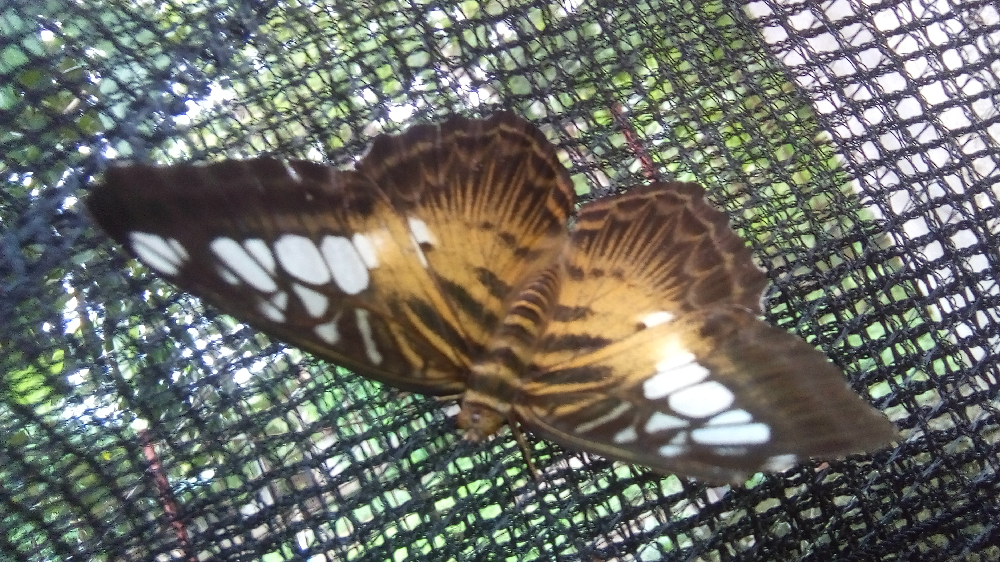

In [122]:
PIL.Image.open(str(Clippers[11]))

In [ ]:
butterfly_images_dict={
'Atlas Moth Butterfly':list(data_dir.glob('*Atlas Moth Butterfly/*.jpg')),
'Clippers Butterfly':list(data_dir.glob('*Clippers Butterfly/*.jpg')),
'Common Jay Butterfly':list(data_dir.glob('*Common Jay Butterfly/*.jpg')),
'Common Jay Eggs':list(data_dir.glob('*Common Jay Eggs/*.jpg')),
'Common Jay Larvae':list(data_dir.glob('*Common Jay Larvae/*.jpg')),
'Common Jay Pupae':list(data_dir.glob('*Common Jay Pupae/*.jpg')),
'Common Lime Butterfly':list(data_dir.glob('*Common Lime Butterfly/*.jpg')),
'Common Lime Defect wings':list(data_dir.glob('*Common Lime Defects wing/*.jpg')),
'Common Lime Deformed body':list(data_dir.glob('*Common Lime Deformed body/*.jpg')),
'Common Lime Eggs':list(data_dir.glob('*Common Lime Eggs/*.jpg')),
'Common Lime Healthy Pupae':list(data_dir.glob('*Common Lime Healthy Pupae/*.jpg')),
'Common Lime Larvae':list(data_dir.glob('*Common Lime Larvae/*.jpg')),
'Common Lime Larvae Instar':list(data_dir.glob('*Common Lime Larva instar/*.jpg')),
'Common Lime Pupae':list(data_dir.glob('*Common Lime Pupae/*.jpg')),
'Common Mormon Butterfly':list(data_dir.glob('*Common Mormon Butterfly/*.jpg')),
'Common Mormon Overbend Pupae':list(data_dir.glob('*Common Mormon Overbend Pupae/*.jpg')),
'Common mormon Stretched abdomen':list(data_dir.glob('*Common mormon Stretched abdomen/*.jpg')),
'Emerald Swallowtail Butterfly':list(data_dir.glob('*Emerald Swallowtail Butterfly/*.jpg')),
'Golden Birdwing Butterfly':list(data_dir.glob('*rGolden Birdwing Butterfly/*.jpg')),
'Golden Birdwing defects pupae':list(data_dir.glob('*Golden Birdwing defects pupae/*.jpg')),
'Golden Birdwing disease larvae':list(data_dir.glob('*Golden Birdwing disease larvae/*.jpg')),
'Golden Birdwing eggs':list(data_dir.glob('*Golden Birdwing eggs/*.jpg')),
'Golden Birdwing healthy larvae':list(data_dir.glob('*Golden Birdwing healthy larvae/*.jpg')),
'Golden Birdwing healthy pupae':list(data_dir.glob('*Golden Birdwing healthy pupae/*.jpg')),
'Golden Birdwing larvae':list(data_dir.glob('*Golden Birdwing larvae/*.jpg')),
'Golden Birdwing Larvae eggs':list(data_dir.glob('*Golden Birdwing Larvae eggs/*.jpg')),
'Golden Birdwing Larvae instar':list(data_dir.glob('*Golden Birdwing Larvae instar/*.jpg')),
'Golden Birdwing Prepupae Larvae':list(data_dir.glob('*Golden Birdwing Prepupae Larvae/*.jpg')),
'Golden Birdwing Pupae':list(data_dir.glob('*Golden Birdwing Pupae/*.jpg')),
'Golden Birdwing predators ants':list(data_dir.glob('*Golden Birdwing predators ants/*.jpg')),
'Great Eggfly Butterfly':list(data_dir.glob('*Great Eggfly Butterfly/*.jpg')),
'Great Yellow Mormon Butterfly':list(data_dir.glob('*Great Yellow Mormon Butterfly/*.jpg')),
'Paper Kite Butterfly':list(data_dir.glob('*Paper Kite Butterfly/*.jpg')),
'Paper Kite Pupae':list(data_dir.glob('*Paper Kite Pupae/*.jpg')),
'Pink Rose Butterfly':list(data_dir.glob('*Pink Rose Butterfly/*.jpg')),
'Pink Rose Eggs':list(data_dir.glob('*Pink Rose Eggs/*.jpg')),
'Pink Rose Larvae':list(data_dir.glob('*Pink Rose Larvae/*.jpg')),
'Pink Rose Pupae':list(data_dir.glob('*Pink Rose Pupae/*.jpg')),
'Plain Tiger Butterfly':list(data_dir.glob('*Plain Tiger Butterfly/*.jpg')),
'Plain Tiger Eggs':list(data_dir.glob('*Plain Tiger Eggss/*.jpg')),
'Plain Tiger Larvae Disease':list(data_dir.glob('*Plain Tiger Larvae Disease/*.jpg')),
'Plain Tiger Larvae':list(data_dir.glob('*Plain Tiger Larvae/*.jpg')),
'Plain Tiger Old Pupae':list(data_dir.glob('*Plain Tiger Old Pupae/*.jpg')),
'Plain Tiger Pupae':list(data_dir.glob('*Plain Tiger Pupae/*.jpg')),
'Scarlet Mormon Butterfly':list(data_dir.glob('*Scarlet Mormon Butterfly/*.jpg')),
'Tailed Jay Butterfly':list(data_dir.glob('*Tailed Jay Butterfly/*.jpg')),
'Tailed Jay Eggs':list(data_dir.glob('*Tailed Jay Eggs/*.jpg')),
'Tailed Jay Larvae':list(data_dir.glob('*Tailed Jay Larvae/*.jpg')),
'Tailed Jay Pupae':list(data_dir.glob('*Tailed Jay Pupae/*.jpg')),
}


In [138]:
str(butterfly_images_dict['Tailed Jay Pupae'][0:5])

'[]'

In [124]:
butterfly_labels_dict={
'Atlas Moth Butterfly':0,'Clippers Butterfly':1,'Common Jay Butterfly':2,'Common Jay Eggs':3,'Common Jay Larvae':4,'Common Jay Pupae':5,'Common Lime Butterfly':6,'Common Lime Defect wings':7,'Common Lime Deformed body':8,'Common Lime Eggs':9,'Common Lime Healthy Pupae':10,'Common Lime Larvae':11,'Common Lime Larvae Instar':12,'Common Lime Pupae':13,'Common Mormon Butterfly':14,'Common Mormon Overbend Pupae':15,'Common mormon Stretched abdomen':16,'Emerald Swallowtail Butterfly':17,'Golden Birdwing Butterfly':18,'Golden Birdwing defects pupae':19,'Golden Birdwing disease larvae':20,'Golden Birdwing eggs':21,'Golden Birdwing healthy larvae':22,'Golden Birdwing healthy pupae':23,'Golden Birdwing larvae':24,'Golden Birdwing Larvae eggs':25,'Golden Brdwing Larvae instar':26,'Golden Birdwing Prepupae Larvae':27,'Golden Birdwing Pupae':28,'Golden Birdwing predators ants':29,'Great Eggfly Butterfly':30,'Great Yellow Mormon Butterfly':31,'Paper Kite Butterfly':32,'Paper Kite Pupae':33,'Pink Rose Butterfly':34,'Pink Rose Eggs':35,'Pink Rose Larvae':36,'Pink Rose Pupae':37,'Plain Tiger Butterfly':38,'Plain Tiger Eggs':39,'Plain Tiger Larvae Disease':40,'Plain Tiger Larvae':41,'Plain Tiger Old Pupae':42,'Plain Tiger Pupae':43,'Scarlet Mormon Butterfly':44,'Tailed Jay Butterfly':45,'Tailed Jay Eggs':46,'Tailed Jay Larvae':47,'Tailed Jay Pupae':48}

In [139]:
str(butterfly_images_dict['Common Jay Butterfly'][0])


'c:\\Butterfly\\Common Jay Butterfly\\70013.jpg'

In [126]:
img=cv2.imread(str(butterfly_images_dict['Common Jay Butterfly'][0]))
img.shape


(138, 191, 3)

In [127]:
cv2.resize(img,(100,100)).shape

(100, 100, 3)

In [133]:
X,y=[],[]
for butterfly_name,images in butterfly_images_dict.items():
    for image in images:
        img=cv2.imread(str(image))
        resized_img=cv2.resize(img,(180,180))
        X.append(resized_img)
        y.append(butterfly_labels_dict[butterfly_name])
    

KeyError: 'Golden Birdwing Larvae instar'

In [ ]:
butterfly_labels_dict={
'Atlas Moth Butterfly':0,'Clippers Butterfly':1,'Common Jay Butterfly':2,'Common Jay Eggs':3,'Common Jay Larvae':4,'Common Jay Pupae':5,'Common Lime Butterfly':6,'Common Lime Defect wings':7,'Common Lime Deformed body':8,'Common Lime Eggs':9,'Common Lime Healthy Pupae':10,'Common Lime Larvae':11,'Common Lime Larvae Instar':12,'Common Lime Pupae':13,'Common Mormon Butterfly':14,'Common Mormon Overbend Pupae':15,'Common mormon Stretched abdomen':16,'Emerald Swallowtail Butterfly':17,'Golden Birdwing Butterfly':18,'Golden Birdwing defects pupae':19,'Golden Birdwing disease larvae':20,'Golden Birdwing eggs':21,'Golden Birdwing healthy larvae':22,'Golden Birdwing healthy pupae':23,'Golden Birdwing larvae':24,'Golden Birdwing Larvae eggs':25,'Golden Brdwing Larvae instar':26,'Golden Birdwing Prepupae Larvae':27,'Golden Birdwing Pupae':28,'Golden Birdwing predators ants':29,'Great Eggfly Butterfly':30,'Great Yellow Mormon Butterfly':31,'Paper Kite Butterfly':32,'Paper Kite Pupae':33,'Pink Rose Butterfly':34,'Pink Rose Eggs':35,'Pink Rose Larvae':36,'Pink Rose Pupae':37,'Plain Tiger Butterfly':38,'Plain Tiger Eggs':39,'Plain Tiger Larvae Disease':40,'Plain Tiger Larvae':41,'Plain Tiger Old Pupae':42,'Plain Tiger Pupae':43,'Scarlet Mormon Butterfly':44,'Tailed Jay Butterfly':45,'Tailed Jay Eggs':46,'Tailed Jay Larvae':47,'Tailed Jay Pupae':48}


In [ ]:
butterfly_labels_dict.items()

dict_items([('Atlas Moth Butterfly', 0), ('Clippers Butterfly', 1), ('Common Jay Butterfly', 2), ('Common Jay Eggs', 3), ('Common Jay Larvae', 4), ('Common Jay Pupae', 5), ('Common Lime Butterfly', 6), ('Common Lime Defect wings', 7), ('Common Lime Deformed body', 8), ('Common Lime Eggs', 9), ('Common Lime Healthy Pupae', 10), ('Common Lime Larvae', 11), ('Common Lime Larvae Instar', 12), ('Common Lime Pupae', 13), ('Common Mormon Butterfly', 14), ('Common Mormon Overbend Pupae', 15), ('Common mormon Stretched abdomen', 16), ('Emerald Swallowtail Butterfly', 17), ('Golden Birdwing Butterfly', 18), ('Golden Birdwing defects pupae', 19), ('Golden Birdwing disease larvae', 20), ('Golden Birdwing eggs', 21), ('Golden Birdwing healthy larvae', 22), ('Golden Birdwing healthy pupae', 23), ('Golden Birdwing larvae', 24), ('Golden Birdwing Larvae eggs', 25), ('Golden Brdwing Larvae instar', 26), ('Golden Birdwing Prepupae Larvae', 27), ('Golden Birdwing Pupae', 28), ('Golden Birdwing predators 

In [ ]:
butterfly_labels_dict.keys()

dict_keys(['Atlas Moth Butterfly', 'Clippers Butterfly', 'Common Jay Butterfly', 'Common Jay Eggs', 'Common Jay Larvae', 'Common Jay Pupae', 'Common Lime Butterfly', 'Common Lime Defect wings', 'Common Lime Deformed body', 'Common Lime Eggs', 'Common Lime Healthy Pupae', 'Common Lime Larvae', 'Common Lime Larvae Instar', 'Common Lime Pupae', 'Common Mormon Butterfly', 'Common Mormon Overbend Pupae', 'Common mormon Stretched abdomen', 'Emerald Swallowtail Butterfly', 'Golden Birdwing Butterfly', 'Golden Birdwing defects pupae', 'Golden Birdwing disease larvae', 'Golden Birdwing eggs', 'Golden Birdwing healthy larvae', 'Golden Birdwing healthy pupae', 'Golden Birdwing larvae', 'Golden Birdwing Larvae eggs', 'Golden Brdwing Larvae instar', 'Golden Birdwing Prepupae Larvae', 'Golden Birdwing Pupae', 'Golden Birdwing predators ants', 'Great Eggfly Butterfly', 'Great Yellow Mormon Butterfly', 'Paper Kite Butterfly', 'Paper Kite Pupae', 'Pink Rose Butterfly', 'Pink Rose Eggs', 'Pink Rose Larv

In [ ]:
butterfly_labels_dict.values()

dict_values([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48])

In [ ]:
butterfly_images_dict

{'Atlas Moth Butterfly': [WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00001.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00002.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00003.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00004.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00005.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00006.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00007.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00008.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00009.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00010.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00011.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00012.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00013.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00014.jpg'),
  WindowsPath('c:/Butterfly/Atlas Moth Butterfly/AA00015.jpg'),
  WindowsPath('c

In [ ]:
#butterfly_images_dict.items()

In [ ]:
butterfly_labels_dict.items()

dict_items([('Atlas Moth Butterfly', 0), ('Clippers Butterfly', 1), ('Common Jay Butterfly', 2), ('Common Jay Eggs', 3), ('Common Jay Larvae', 4), ('Common Jay Pupae', 5), ('Common Lime Butterfly', 6), ('Common Lime Defect wings', 7), ('Common Lime Deformed body', 8), ('Common Lime Eggs', 9), ('Common Lime Healthy Pupae', 10), ('Common Lime Larvae', 11), ('Common Lime Larvae Instar', 12), ('Common Lime Pupae', 13), ('Common Mormon Butterfly', 14), ('Common Mormon Overbend Pupae', 15), ('Common mormon Stretched abdomen', 16), ('Emerald Swallowtail Butterfly', 17), ('Golden Birdwing Butterfly', 18), ('Golden Birdwing defects pupae', 19), ('Golden Birdwing disease larvae', 20), ('Golden Birdwing eggs', 21), ('Golden Birdwing healthy larvae', 22), ('Golden Birdwing healthy pupae', 23), ('Golden Birdwing larvae', 24), ('Golden Birdwing Larvae eggs', 25), ('Golden Brdwing Larvae instar', 26), ('Golden Birdwing Prepupae Larvae', 27), ('Golden Birdwing Pupae', 28), ('Golden Birdwing predators 

In [ ]:
data_dir=tensorflow.keras.preprocessing.image_dataset_from_directory('c:/Butterfly')

Found 3662 files belonging to 72 classes.


In [ ]:


class_names=data_dir.class_names
print(class_names) 


['Atlas Moth Butterfly', 'Atlas Moth Eggs', 'Atlas Moth Larvae', 'Atlas Moth Pupae', 'Clippers Butterfly', 'Clippers Eggs', 'Clippers Larvae', 'Clippers Pupae', 'Common Jay Butterfly', 'Common Jay Eggs', 'Common Jay Larvae', 'Common Jay Pupae', 'Common Lime Butterfly', 'Common Lime Defect wings', 'Common Lime Deformed body', 'Common Lime Eggs', 'Common Lime Healthy Pupae', 'Common Lime Larvae', 'Common Lime Larvae Instar', 'Common Lime Pupae', 'Common Mormon Butterfly', 'Common Mormon Eggs', 'Common Mormon Larvae', 'Common Mormon Overbend Pupae', 'Common Mormon Pupae', 'Common Mormon Stretched abdomen', 'Emerald Swallowtail Butterfly', 'Emerald Swallowtail Eggs', 'Emerald Swallowtail Larvae', 'Emerald Swallowtail Pupae', 'Golden Birdwing Butterfly', 'Golden Birdwing Larvae eggs', 'Golden Birdwing Larvae instar', 'Golden Birdwing Prepupae Larvae', 'Golden Birdwing Pupae', 'Golden Birdwing defects pupae', 'Golden Birdwing disease larvae', 'Golden Birdwing eggs', 'Golden Birdwing healthy 

In [117]:
# Loading the dataset


In [ ]:
num_classes = len(class_names)


model = Sequential([
  layers.Rescaling(1./255, input_shape=(img_height, img_width, 3)),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes)
])


In [ ]:
model.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_4 (Rescaling)     (None, 180, 180, 3)       0         
                                                                 
 conv2d_12 (Conv2D)          (None, 180, 180, 16)      448       
                                                                 
 max_pooling2d_12 (MaxPooli  (None, 90, 90, 16)        0         
 ng2D)                                                           
                                                                 
 conv2d_13 (Conv2D)          (None, 90, 90, 32)        4640      
                                                                 
 max_pooling2d_13 (MaxPooli  (None, 45, 45, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_14 (Conv2D)          (None, 45, 45, 64)       

In [ ]:
# compiling the sequential model
model.compile(loss='categorical_crossentropy', metrics=['accuracy'], optimizer='adam')

In [118]:
# epochs=10
# history = model.fit(
#   training_data=train_ds,
#   validation_data=val_ds,
#   epochs=epochs
# )
#Fitting
model.fit(butterfly_images_dict, butterfly_labels_dict, epochs=5, batch_size=32)


ValueError: Failed to find data adapter that can handle input: (<class 'dict'> containing {"<class 'str'>"} keys and {"(<class 'list'> containing values of types set())", '(<class \'list\'> containing values of types {"<class \'pathlib.WindowsPath\'>"})'} values), (<class 'dict'> containing {"<class 'str'>"} keys and {"<class 'int'>"} values)

In [ ]:
plt.figure(figsize=(10,10))
for images, labels in train_data.take(1)

SyntaxError: expected ':' (2983214030.py, line 2)